# Perform Inference using a YOLOv3

In [1]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Wed_Jul_22_19:09:09_PDT_2020
Cuda compilation tools, release 11.0, V11.0.221
Build cuda_11.0_bu.TC445_37.28845127_0
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [2]:

# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5.1+cu101 torchvision==0.6.1+cu101 -f https://download.pytorch.org/whl/torch_stable.html

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 704.4MB 25kB/s 
     |████████████████████████████████| 6.7MB 35.1MB/s 
ERROR: torchtext 0.10.0 has requirement torch==1.9.0, but you'll have torch 1.5.1+cu101 which is incompatible.
  Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102


In [3]:
# install mmcv-full thus we could use CUDA operators
!pip install mmcv-full

# Install mmdetection
!rm -rf mmdetection
!git clone https://github.com/open-mmlab/mmdetection.git
%cd mmdetection

!pip install -e .

# install Pillow 7.0.0 back in order to avoid bug in colab
!pip install Pillow==7.0.0

     |████████████████████████████████| 317kB 23.6MB/s 
     |████████████████████████████████| 194kB 47.3MB/s 
  Created wheel for mmcv-full: filename=mmcv_full-1.3.8-cp37-cp37m-linux_x86_64.whl size=25620893 sha256=0eb4254d07c15ed3b4b8e180174ac350b25f14a2b15c701ff323513946804c14
  Stored in directory: /root/.cache/pip/wheels/5a/0d/c3/627bb7a31df052473f9edd2812702d4a0b2e302cb6932c9a91
Successfully built mmcv-full
Cloning into 'mmdetection'...
remote: Enumerating objects: 19001, done.
remote: Counting objects: 100% (531/531), done.
remote: Compressing objects: 100% (245/245), done.
remote: Total 19001 (delta 336), reused 409 (delta 286), pack-reused 18470
Receiving objects: 100% (19001/19001), 21.78 MiB | 33.39 MiB/s, done.
Resolving deltas: 100% (13239/13239), done.
/content/mmdetection
Obtaining file:///content/mmdetection
  Created wheel for terminaltables: filename=terminaltables-3.1.0-cp37-none-any.whl size=15356 sha256=4c7a098dc145711311744c3442ba760e9dc1bbf56cda966e7e64f73ca454f

In [1]:
# Check Pytorch installation
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

# Check MMDetection installation
import mmdet
print(mmdet.__version__)

# Check mmcv installation
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
print(get_compiling_cuda_version())
print(get_compiler_version())

1.5.1+cu101 True
2.13.0
11.0
GCC 7.5


In [2]:
# './yolov3_d53_mstrain-608_273e_coco.py' from model zoo
!mkdir checkpoints
!wget -c https://download.openmmlab.com/mmdetection/v2.0/yolo/yolov3_d53_320_273e_coco/yolov3_d53_320_273e_coco-421362b6.pth \
      -O checkpoints/yolov3_d53_320_273e_coco-421362b6.pth

--2021-06-27 19:11:09--  https://download.openmmlab.com/mmdetection/v2.0/yolo/yolov3_d53_320_273e_coco/yolov3_d53_320_273e_coco-421362b6.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.252.96.35
Connecting to download.openmmlab.com (download.openmmlab.com)|47.252.96.35|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248091419 (237M) [application/octet-stream]
Saving to: ‘checkpoints/yolov3_d53_320_273e_coco-421362b6.pth’

checkpoints/yolov3_ 100%[===================>] 236.60M  8.38MB/s    in 29s     

2021-06-27 19:11:40 (8.08 MB/s) - ‘checkpoints/yolov3_d53_320_273e_coco-421362b6.pth’ saved [248091419/248091419]



In [3]:
from mmdet.apis import inference_detector, init_detector, show_result_pyplot

# Choose to use a config and initialize the detector
config = 'mmdetection/configs/yolo/yolov3_d53_mstrain-608_273e_coco.py'
# Setup a checkpoint file to load
checkpoint = 'checkpoints/yolov3_d53_320_273e_coco-421362b6.pth'
# initialize the detector
model = init_detector(config, checkpoint, device='cuda:0')

/content/mmdetection/mmdet/core/anchor/builder.py:16: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  '``build_anchor_generator`` would be deprecated soon, please use '


Use load_from_local loader


In [4]:
# Use the detector to do inference on a demo image
img = 'mmdetection/demo/demo.jpg'
result = inference_detector(model, img)

/content/mmdetection/mmdet/datasets/utils.py:68: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)
/content/mmdetection/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/content/mmdetection/mmdet/core/anchor/anchor_generator.py:360: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


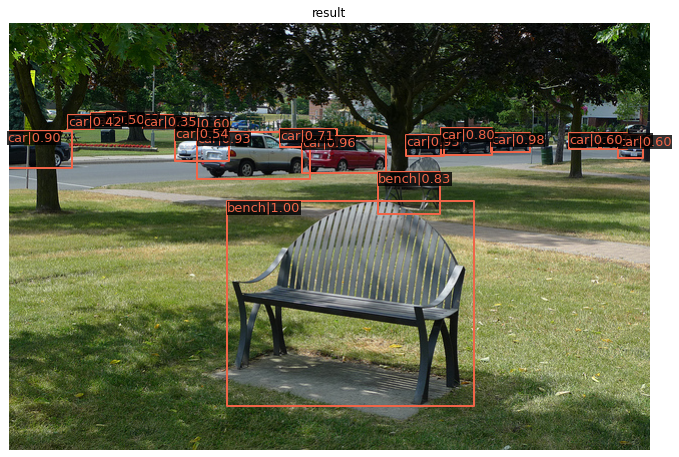

In [5]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3)

In [6]:
# Use the detector to do inference on a non labelled random image
img = 'mmdetection/demo/I-80_Eastshore_Fwy.jpg'
result = inference_detector(model, img)

/content/mmdetection/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/content/mmdetection/mmdet/core/anchor/anchor_generator.py:360: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


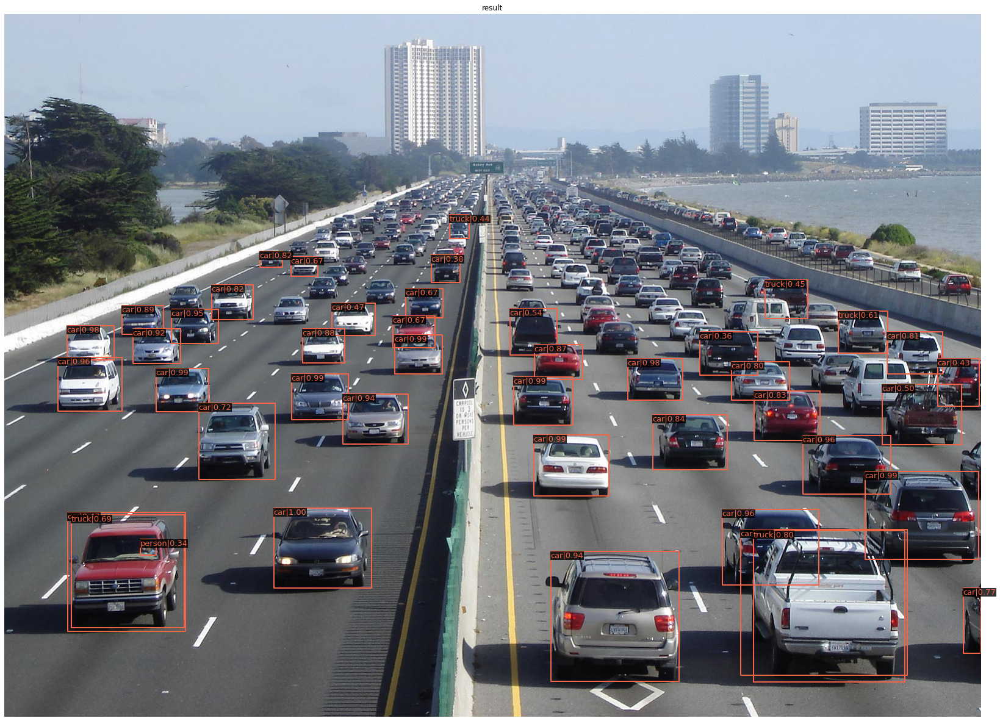

In [7]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3)

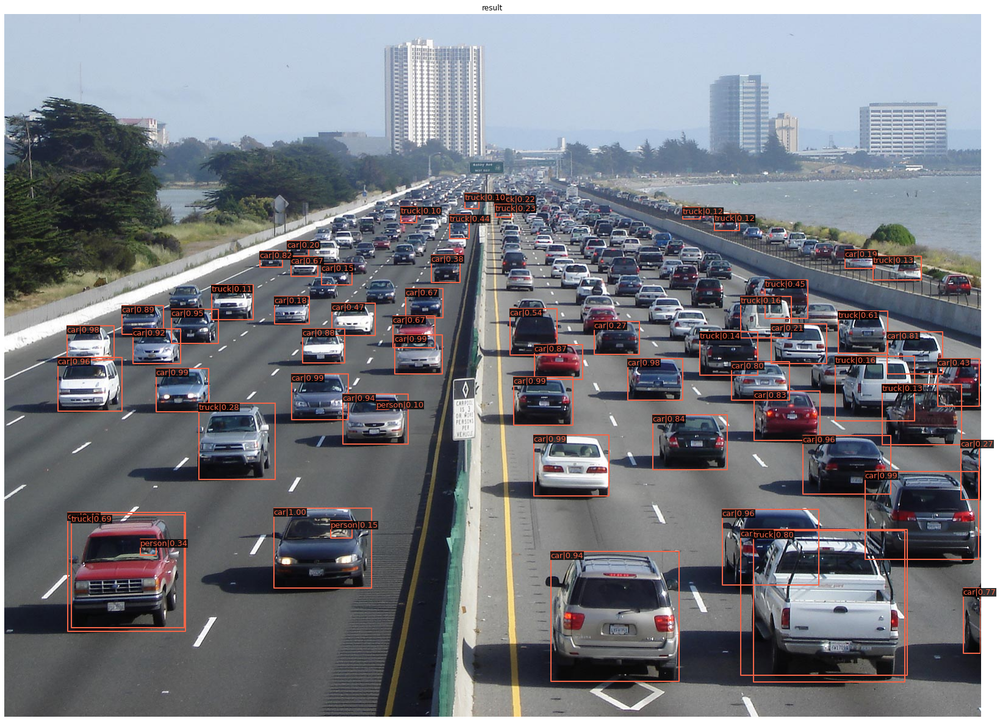

In [9]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.1)

# Evaluation of Yolov3

In [ ]:
# To complete

# Performing Inference using YoloF

In [10]:
# yolof_r50_c5_8x8_1x_coco from mmdetection model zoo
!mkdir checkpoints
!wget -c https://download.openmmlab.com/mmdetection/v2.0/yolof/yolof_r50_c5_8x8_1x_coco/yolof_r50_c5_8x8_1x_coco_20210425_024427-8e864411.pth \
      -O checkpoints/yolof_r50_c5_8x8_1x_coco_20210425_024427-8e864411.pth

      

mkdir: cannot create directory ‘checkpoints’: File exists
--2021-06-27 19:41:24--  https://download.openmmlab.com/mmdetection/v2.0/yolof/yolof_r50_c5_8x8_1x_coco/yolof_r50_c5_8x8_1x_coco_20210425_024427-8e864411.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.252.96.35
Connecting to download.openmmlab.com (download.openmmlab.com)|47.252.96.35|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 176992053 (169M) [application/octet-stream]
Saving to: ‘checkpoints/yolof_r50_c5_8x8_1x_coco_20210425_024427-8e864411.pth’

checkpoints/yolof_r 100%[===================>] 168.79M  8.61MB/s    in 18s     

2021-06-27 19:41:43 (9.53 MB/s) - ‘checkpoints/yolof_r50_c5_8x8_1x_coco_20210425_024427-8e864411.pth’ saved [176992053/176992053]



In [11]:
from mmdet.apis import inference_detector, init_detector, show_result_pyplot

# Choose to use a config and initialize the detector
config = 'mmdetection/configs/yolof/yolof_r50_c5_8x8_1x_coco.py'
# Setup a checkpoint file to load
checkpoint = 'checkpoints/yolof_r50_c5_8x8_1x_coco_20210425_024427-8e864411.pth'
# initialize the detector
model = init_detector(config, checkpoint, device='cuda:0')

/content/mmdetection/mmdet/core/anchor/builder.py:16: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  '``build_anchor_generator`` would be deprecated soon, please use '


Use load_from_local loader


In [12]:
# Use the detector to do inference on a demo image
img = 'mmdetection/demo/demo.jpg'
result = inference_detector(model, img)

/content/mmdetection/mmdet/datasets/utils.py:68: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)
/content/mmdetection/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/content/mmdetection/mmdet/core/anchor/anchor_generator.py:360: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


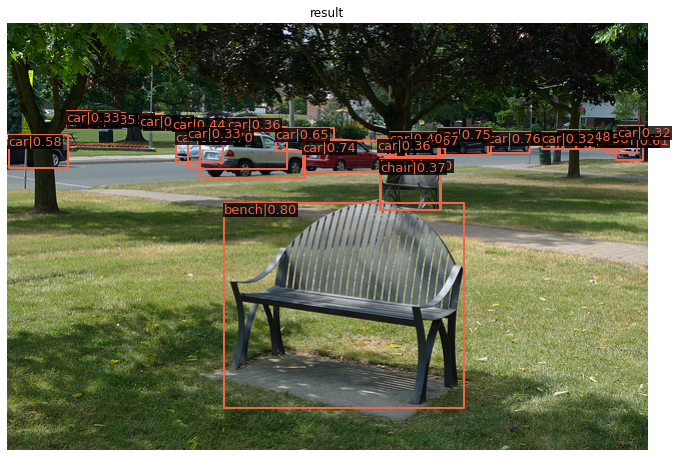

In [13]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3)

In [14]:
# Use the detector to do inference on a non labelled random image
img = 'mmdetection/demo/I-80_Eastshore_Fwy.jpg'
result = inference_detector(model, img)

/content/mmdetection/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/content/mmdetection/mmdet/core/anchor/anchor_generator.py:360: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


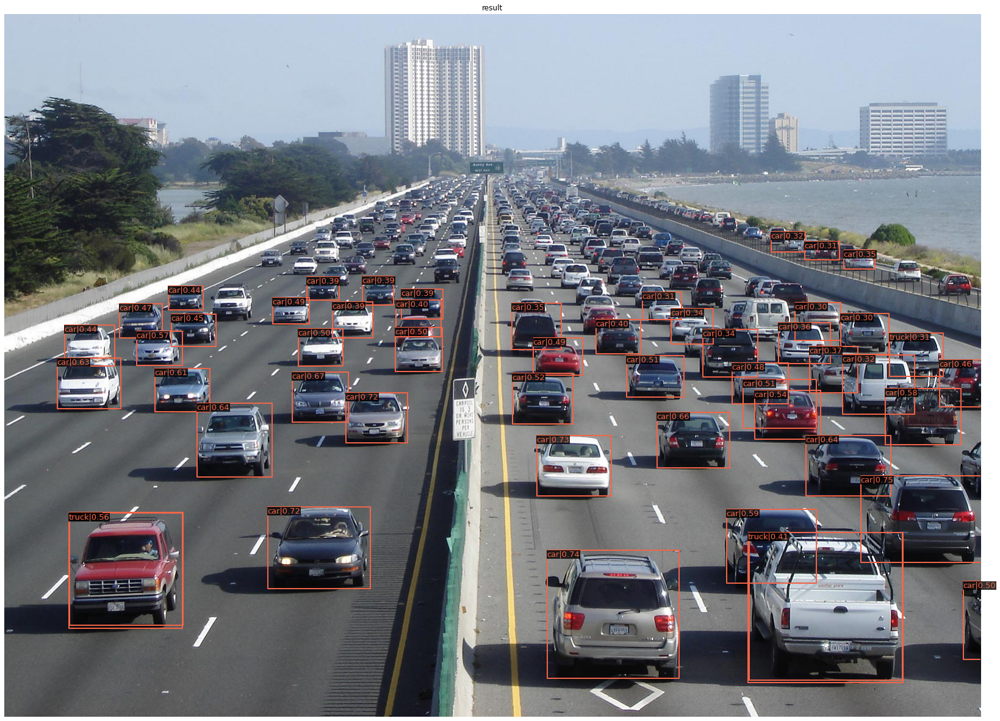

In [15]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3)

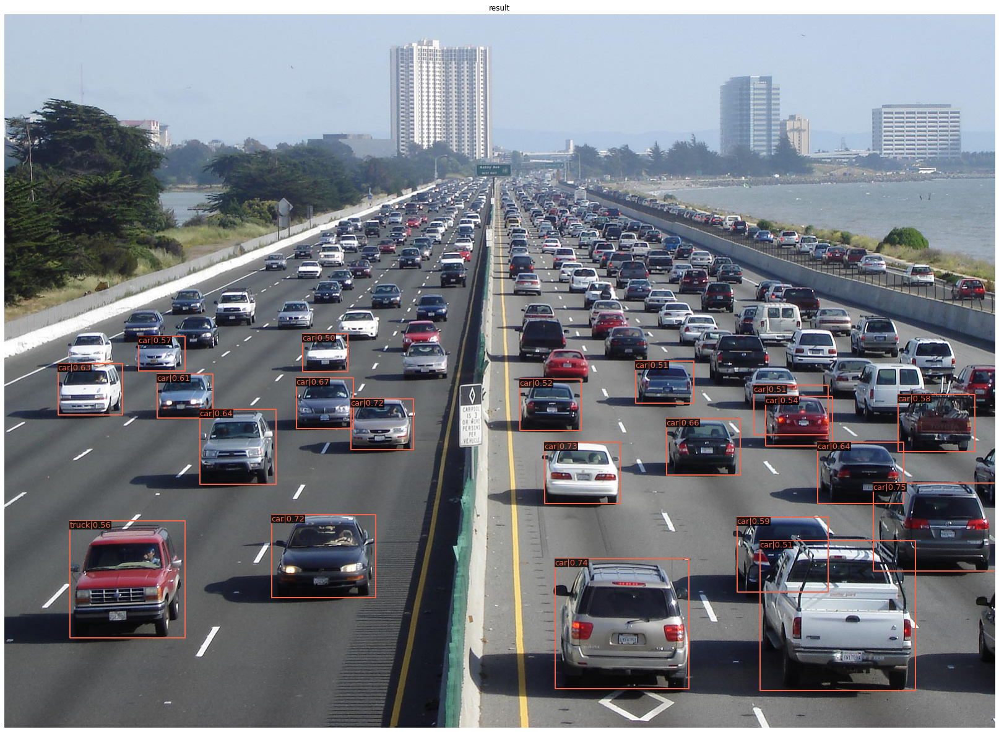

In [16]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.5)

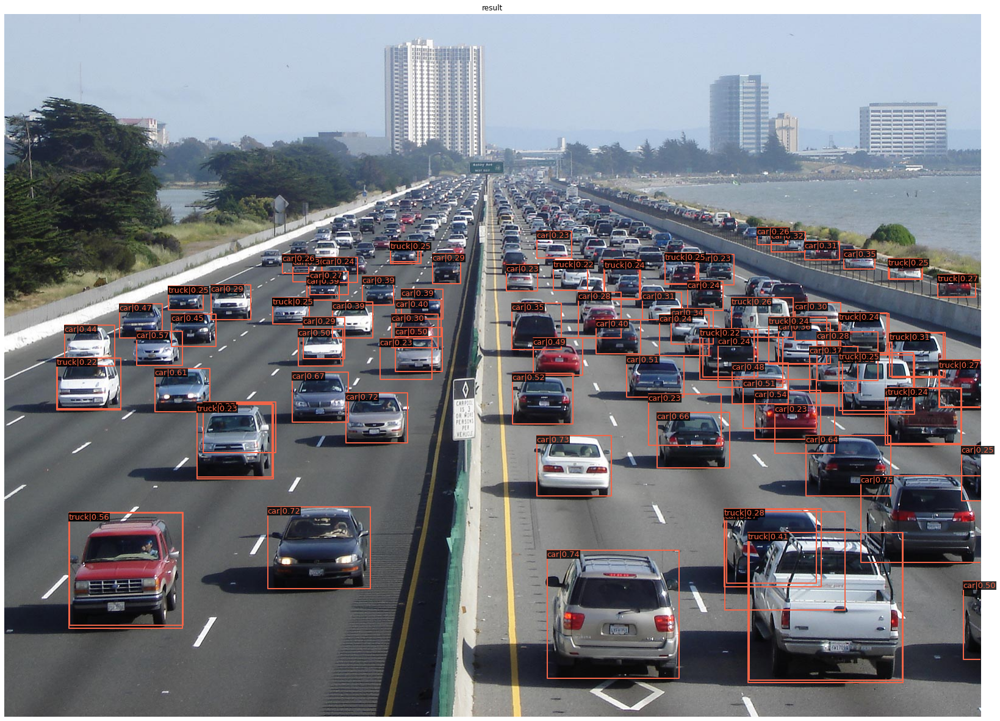

In [17]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.1)

# Performing Inference using RetinaNet

In [19]:
# yolof_r50_c5_8x8_1x_coco from mmdetection model zoo
!mkdir checkpoints
!wget -c https://download.openmmlab.com/mmdetection/v2.0/retinanet/retinanet_r50_caffe_fpn_1x_coco/retinanet_r50_caffe_fpn_1x_coco_20200531-f11027c5.pth \
      -O checkpoints/retinanet_r50_caffe_fpn_1x_coco_20200531-f11027c5.pth

mkdir: cannot create directory ‘checkpoints’: File exists
--2021-06-27 19:53:44--  https://download.openmmlab.com/mmdetection/v2.0/retinanet/retinanet_r50_caffe_fpn_1x_coco/retinanet_r50_caffe_fpn_1x_coco_20200531-f11027c5.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.252.96.35
Connecting to download.openmmlab.com (download.openmmlab.com)|47.252.96.35|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 152151505 (145M) [application/octet-stream]
Saving to: ‘checkpoints/retinanet_r50_caffe_fpn_1x_coco_20200531-f11027c5.pth’

checkpoints/retinan 100%[===================>] 145.10M  6.44MB/s    in 20s     

2021-06-27 19:54:06 (7.18 MB/s) - ‘checkpoints/retinanet_r50_caffe_fpn_1x_coco_20200531-f11027c5.pth’ saved [152151505/152151505]



In [20]:
from mmdet.apis import inference_detector, init_detector, show_result_pyplot

# Choose to use a config and initialize the detector
config = 'mmdetection/configs/retinanet/retinanet_r50_caffe_fpn_1x_coco.py'
# Setup a checkpoint file to load
checkpoint = 'checkpoints/retinanet_r50_caffe_fpn_1x_coco_20200531-f11027c5.pth'
# initialize the detector
model = init_detector(config, checkpoint, device='cuda:0')

/content/mmdetection/mmdet/core/anchor/builder.py:16: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  '``build_anchor_generator`` would be deprecated soon, please use '


Use load_from_local loader


In [21]:
# Use the detector to do inference on a demo image
img = 'mmdetection/demo/demo.jpg'
result = inference_detector(model, img)

/content/mmdetection/mmdet/datasets/utils.py:68: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)
/content/mmdetection/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/content/mmdetection/mmdet/core/anchor/anchor_generator.py:360: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


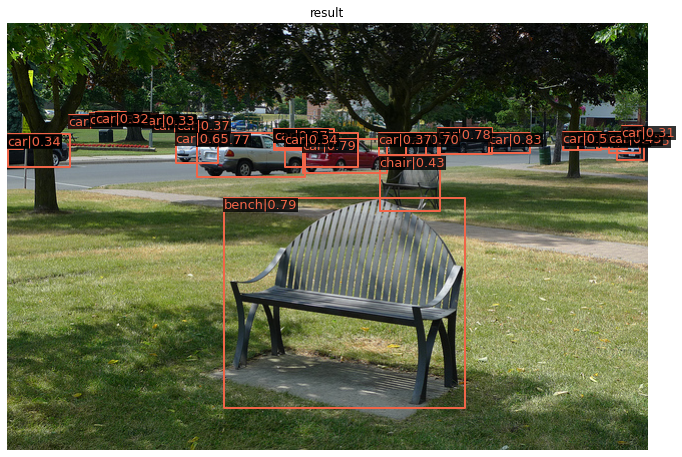

In [22]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3)

In [23]:
# Use the detector to do inference on a non labelled random image
img = 'mmdetection/demo/I-80_Eastshore_Fwy.jpg'
result = inference_detector(model, img)

/content/mmdetection/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/content/mmdetection/mmdet/core/anchor/anchor_generator.py:360: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '


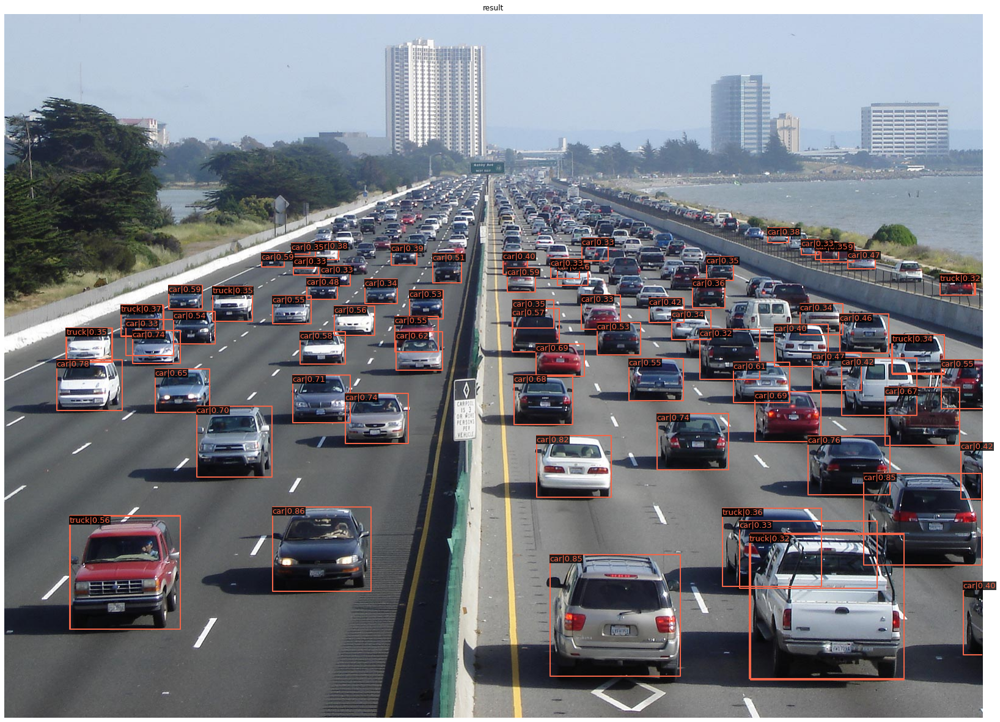

In [24]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3)

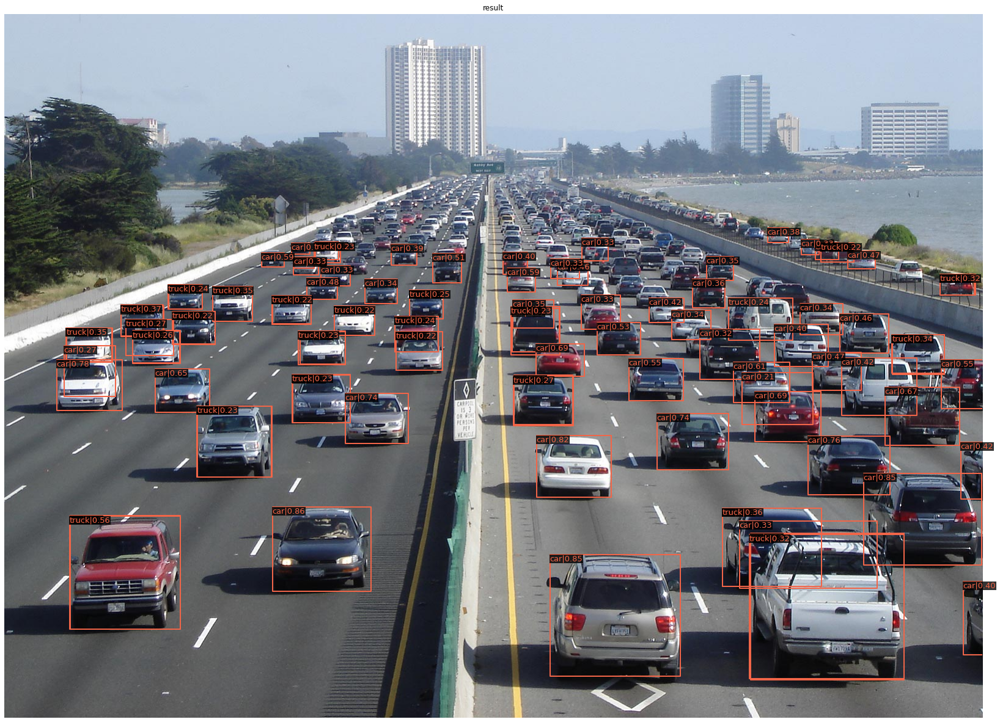

In [25]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.1)

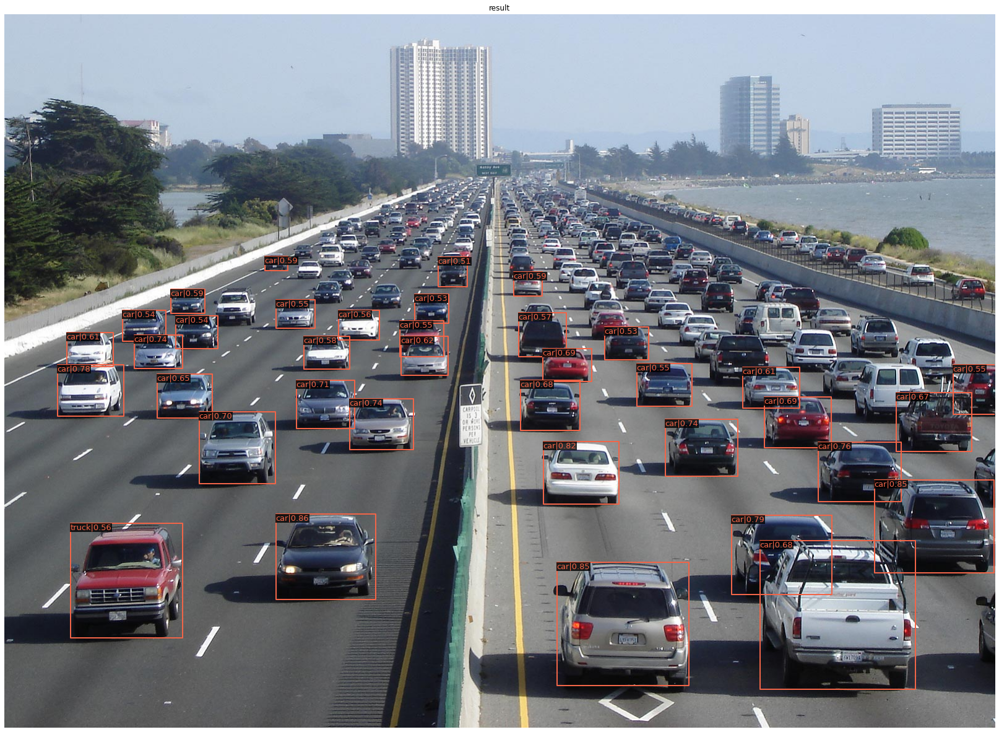

In [26]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.5)

# Performing inference using DETR

In [27]:
# detr_r50_8x2_150e_coco from mmdetection model zoo
!mkdir checkpoints
!wget -c https://download.openmmlab.com/mmdetection/v2.0/detr/detr_r50_8x2_150e_coco/detr_r50_8x2_150e_coco_20201130_194835-2c4b8974.pth \
      -O checkpoints/detr_r50_8x2_150e_coco_20201130_194835-2c4b8974.pth

mkdir: cannot create directory ‘checkpoints’: File exists
--2021-06-27 20:01:42--  https://download.openmmlab.com/mmdetection/v2.0/detr/detr_r50_8x2_150e_coco/detr_r50_8x2_150e_coco_20201130_194835-2c4b8974.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.252.96.35
Connecting to download.openmmlab.com (download.openmmlab.com)|47.252.96.35|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 166698982 (159M) [application/octet-stream]
Saving to: ‘checkpoints/detr_r50_8x2_150e_coco_20201130_194835-2c4b8974.pth’

checkpoints/detr_r5 100%[===================>] 158.98M  7.98MB/s    in 19s     

2021-06-27 20:02:03 (8.22 MB/s) - ‘checkpoints/detr_r50_8x2_150e_coco_20201130_194835-2c4b8974.pth’ saved [166698982/166698982]



In [28]:
from mmdet.apis import inference_detector, init_detector, show_result_pyplot

# Choose to use a config and initialize the detector
config = 'mmdetection/configs/detr/detr_r50_8x2_150e_coco.py'
# Setup a checkpoint file to load
checkpoint = 'checkpoints/detr_r50_8x2_150e_coco_20201130_194835-2c4b8974.pth'
# initialize the detector
model = init_detector(config, checkpoint, device='cuda:0')

/usr/local/lib/python3.7/dist-packages/mmcv/cnn/bricks/transformer.py:348: UserWarning: The arguments `feedforward_channels` in BaseTransformerLayer has been deprecated, now you should set `feedforward_channels` and other FFN related arguments to a dict named `ffn_cfgs`. 
  f'The arguments `{ori_name}` in BaseTransformerLayer '
/usr/local/lib/python3.7/dist-packages/mmcv/cnn/bricks/transformer.py:348: UserWarning: The arguments `ffn_dropout` in BaseTransformerLayer has been deprecated, now you should set `ffn_drop` and other FFN related arguments to a dict named `ffn_cfgs`. 
  f'The arguments `{ori_name}` in BaseTransformerLayer '
/usr/local/lib/python3.7/dist-packages/mmcv/cnn/bricks/transformer.py:91: UserWarning: The arguments `dropout` in MultiheadAttention has been deprecated, now you can separately set `attn_drop`(float), proj_drop(float), and `dropout_layer`(dict) 
  warnings.warn('The arguments `dropout` in MultiheadAttention '
/usr/local/lib/python3.7/dist-packages/mmcv/cnn/br

Use load_from_local loader


In [29]:
# Use the detector to do inference on a demo image
img = 'mmdetection/demo/demo.jpg'
result = inference_detector(model, img)

/content/mmdetection/mmdet/datasets/utils.py:68: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)


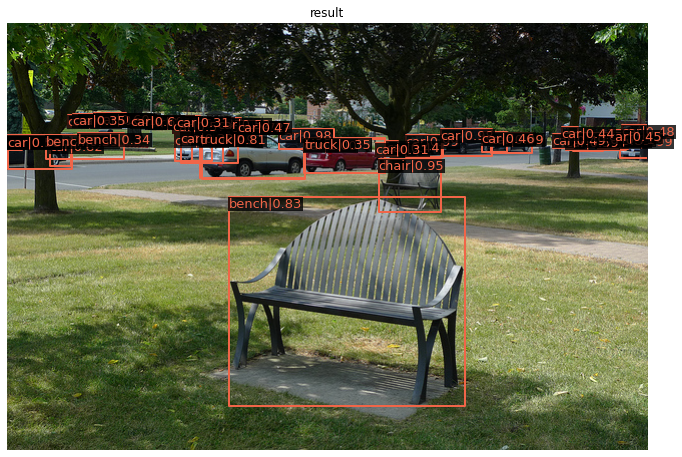

In [31]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3)

In [32]:
# Use the detector to do inference on a non labelled random image
img = 'mmdetection/demo/I-80_Eastshore_Fwy.jpg'
result = inference_detector(model, img)

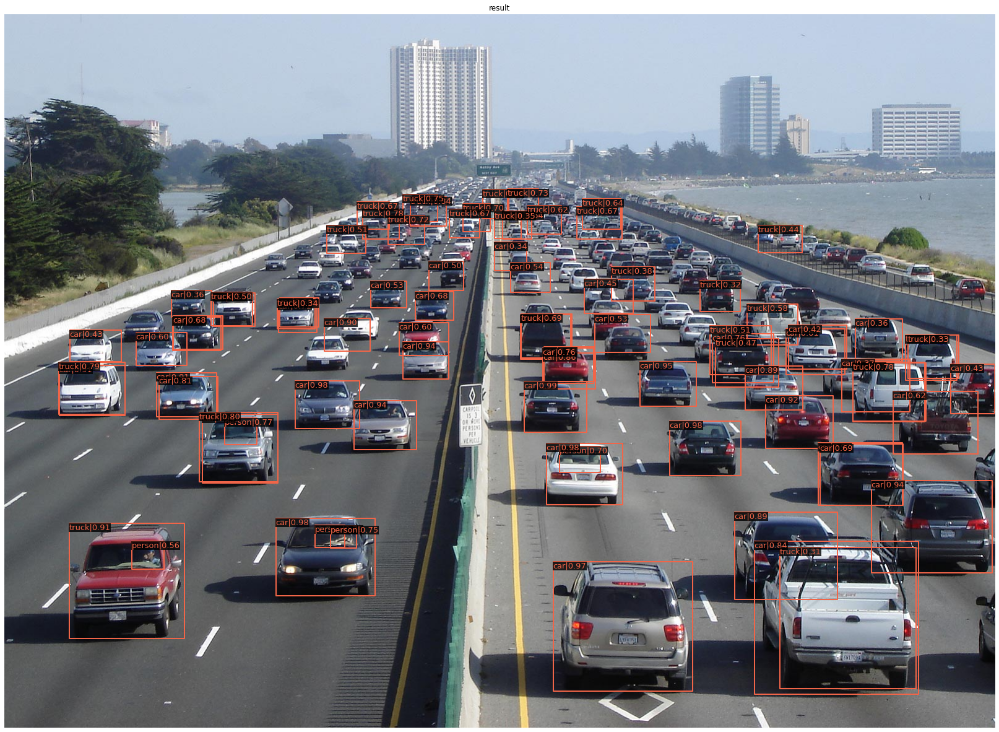

In [33]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3)

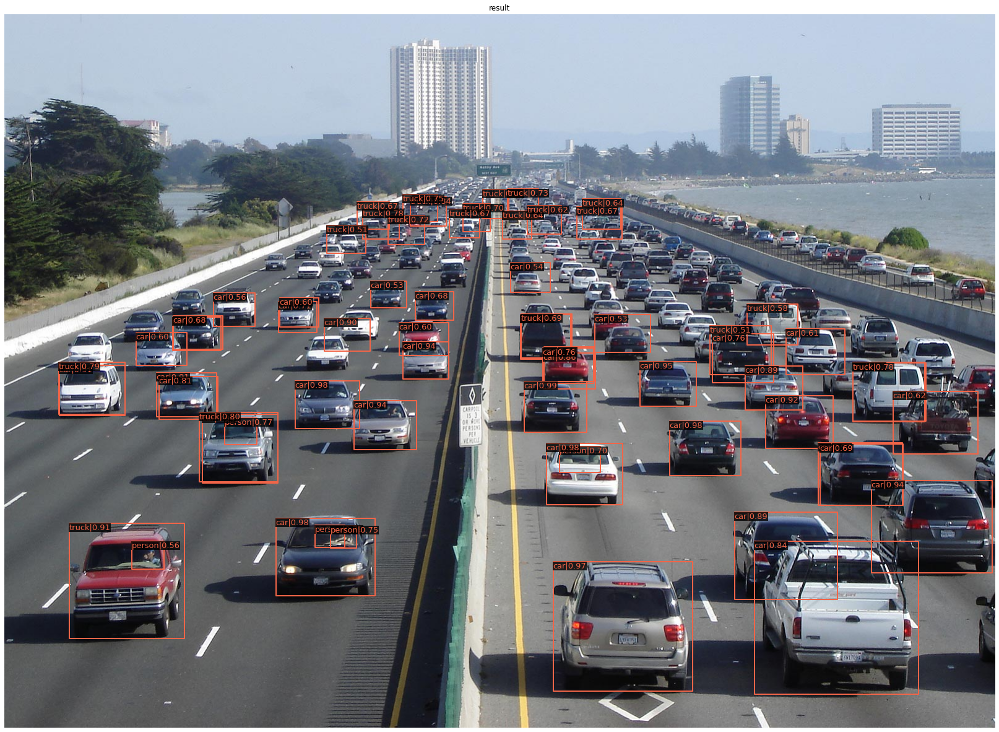

In [34]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.5)

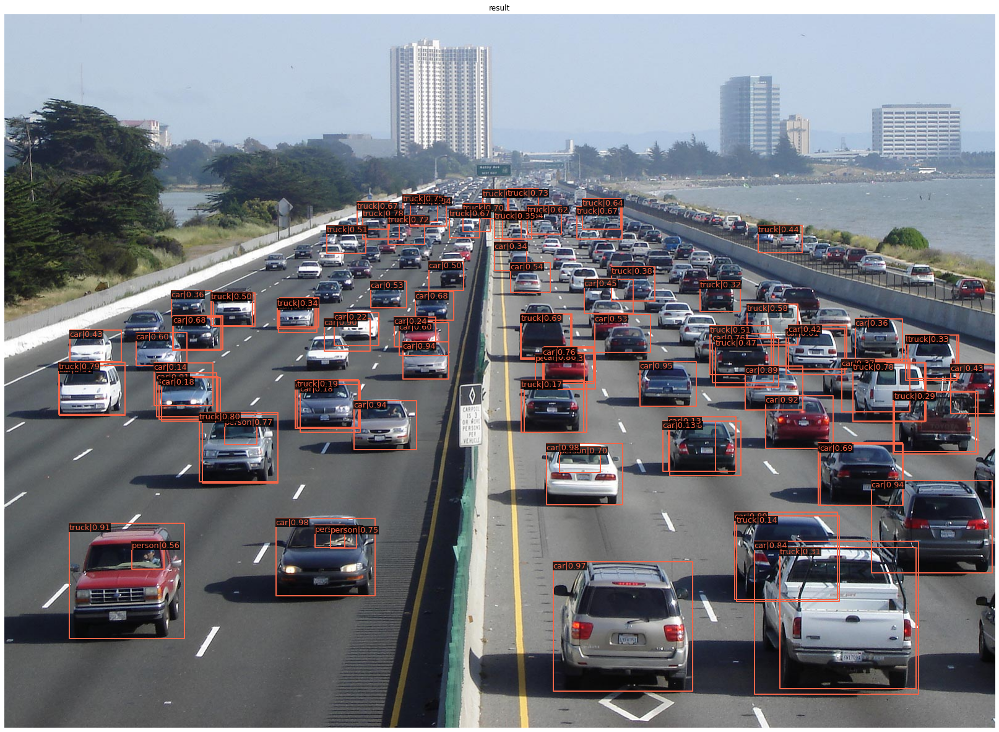

In [35]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.1)